# Vector fields and developmental trajectories of tissue development in three-dimensional space

In [1]:
import os, warnings
from pathlib import Path

import numpy as np
import dynamo as dyn
import spateo as st
import scanpy as sc
warnings.filterwarnings('ignore')

/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/pc001/anaconda3/envs/BioProjects/lib/python3.8/site-packag

## Load the data

In [2]:
sample_id = "E7_8h"
os.chdir(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_{sample_id}_germ_layer_new")
cpo = [(41, 1209, 57), (13, 8, -3), (0, 0, 1)]

out_image_path = f"image/germband_morphofield"
Path(out_image_path).mkdir(parents=True, exist_ok=True)

In [4]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband_v3.h5ad")
germ_adata = germ_adata[germ_adata.obs["anno_tissue_new"] != "epidermis", :]
germ_adata = germ_adata[germ_adata.layers["X_counts"].sum(axis=1)!=0, germ_adata.layers["X_counts"].sum(axis=0)!=0]

import anndata as ad
amnioserosa_adata = st.read_h5ad(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_E7_8h_germ_layer/h5ad/E7_8h_mapping_amnioserosa.h5ad")
amnioserosa_adata = amnioserosa_adata[amnioserosa_adata.layers["X_counts"].sum(axis=1)!=0, amnioserosa_adata.layers["X_counts"].sum(axis=0)!=0]
germ_adata = ad.concat([germ_adata, amnioserosa_adata], axis=0, join="outer")
germ_adata = germ_adata[germ_adata.layers["X_counts"].sum(axis=1)!=0, germ_adata.layers["X_counts"].sum(axis=0)!=0]

germ_pc, _ = st.tdr.construct_pc(
    adata=germ_adata.copy(),
    spatial_key="3d_align_spatial",
    groupby="anno_tissue_new",
    key_added="tissue",
    colormap={"amnioserosa": "#bdcf32", "CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",},
)
germ_adata

View of AnnData object with n_obs × n_vars = 13354 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

## Check mapping result

In [5]:
stage2_germ_adata = st.read_h5ad(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_E8_9h_germ_layer/h5ad/E8_9h_germ_layer_v3.h5ad")
stage2_amnioserosa_adata = st.read_h5ad(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_E8_9h/h5ad/E8_9h_cellbin_v2_amnioserosa.h5ad")
stage2_germ_adata = ad.concat([stage2_germ_adata, stage2_amnioserosa_adata], axis=0, join="outer")
stage2_germ_adata = stage2_germ_adata[stage2_germ_adata.layers["X_counts"].sum(axis=1)!=0, stage2_germ_adata.layers["X_counts"].sum(axis=0)!=0]
stage2_germ_pc, _ = st.tdr.construct_pc(
    adata=stage2_germ_adata.copy(),
    spatial_key="3d_align_spatial",
    groupby="anno_tissue_new",
    key_added="tissue",
    colormap={"amnioserosa": "#bdcf32", "CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",},
)
models_distance = np.asarray([0, 0, -260])
stage2_germ_pc.points = stage2_germ_pc.points + models_distance
stage2_germ_adata

View of AnnData object with n_obs × n_vars = 12517 × 8462
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

In [6]:
from dynamo.tools.sampling import trn
sub_arr = trn(X=germ_adata.obsm["3d_align_spatial"], n=5000, return_index=True, seed=19491001)

KeyboardInterrupt: 

In [5]:
model_lines, _ = st.tdr.construct_align_lines(
            model1_points=germ_adata.obsm["3d_align_spatial"][sub_arr].copy(), # [sub_arr]
            model2_points=germ_adata.obsm["X_cells_mapping"][sub_arr] + models_distance,
            key_added="mapping",
            label="mapping lines",
            color="gainsboro",
            alpha=1.0,
        )

mapping_cpo = [(18, 1370, -141),(-1.8, 5.8, -156.8), (0, 0, 1)]
st.pl.three_d_plot(
        model=st.tdr.collect_models([model_lines, st.tdr.merge_models([germ_pc, stage2_germ_pc])]),
        key=["mapping", "tissue"],
        jupyter="static",
        cpo=mapping_cpo,
        background="white",
        window_size=(2560, 2048),
        opacity=[0.1, 1],
        model_style=["wireframe", "points"],
        model_size=[2, 14],
        filename=os.path.join(out_image_path, f"E7-8h-E8-9h_germband_mapping_z_model_260.pdf"),
    )

In [6]:
mapping_cpo = [(18, 1370, -141),(-1.8, 5.8, -156.8), (0, 0, 1)]
st.pl.three_d_plot(
    model=st.tdr.collect_models([germ_pc, stage2_germ_pc, model_lines]),
    key=["tissue", "tissue", "mapping"],
    filename=os.path.join(out_image_path, f"Germband_mapping_model_animation.mp4"),
    model_size=[14, 14, 2],
    model_style=["points", "points", "wireframe"],
    opacity=[1, 1, 0.1],
    show_legend=True,
    off_screen=False,
    jupyter="static",
    background="white",
    window_size=(2560, 2048),
    cpo=mapping_cpo,
    text=f"\n3D alignment of Germ band (Drosophila S11&S13)",
    text_kwargs={"font_size":20},
    view_up=(0, 0, 1),
    framerate=6
)

## Calculate the developmental Vectorfield

In [7]:
st.tdr.morphofield_sparsevfc(
    adata=germ_adata,
    spatial_key="3d_align_spatial",
    V_key="V_cells_mapping",
    key_added="VecFld_morpho",
    NX=np.asarray(germ_pc.points),
    inplace=True,
)
germ_pc.point_data["vectors"] = germ_adata.uns["VecFld_morpho"]["V"]

|-----? The length of [  0 100 200 300 400] is different from 10, using `np.range(restart_num) * 100
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] completed [0.1012s]
|-----> Current cosine correlation (0.7935) between input velocities and learned velocities is less than 0.8. Make a 1-th vector field reconstruction trial.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] completed [0.1486s]
|-----> Current cosine correlation (0.79063) between input velocities and learned velocities is less than 0.8. Make a 2-th vector field reconstruction trial.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] completed [0.2145s]
|-----> Current cosine correlation (0.79153) between input velocities and learned velocities is less than 0.8. Make a 3-th vector field reconstruction trial.
|-----> [Spa

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


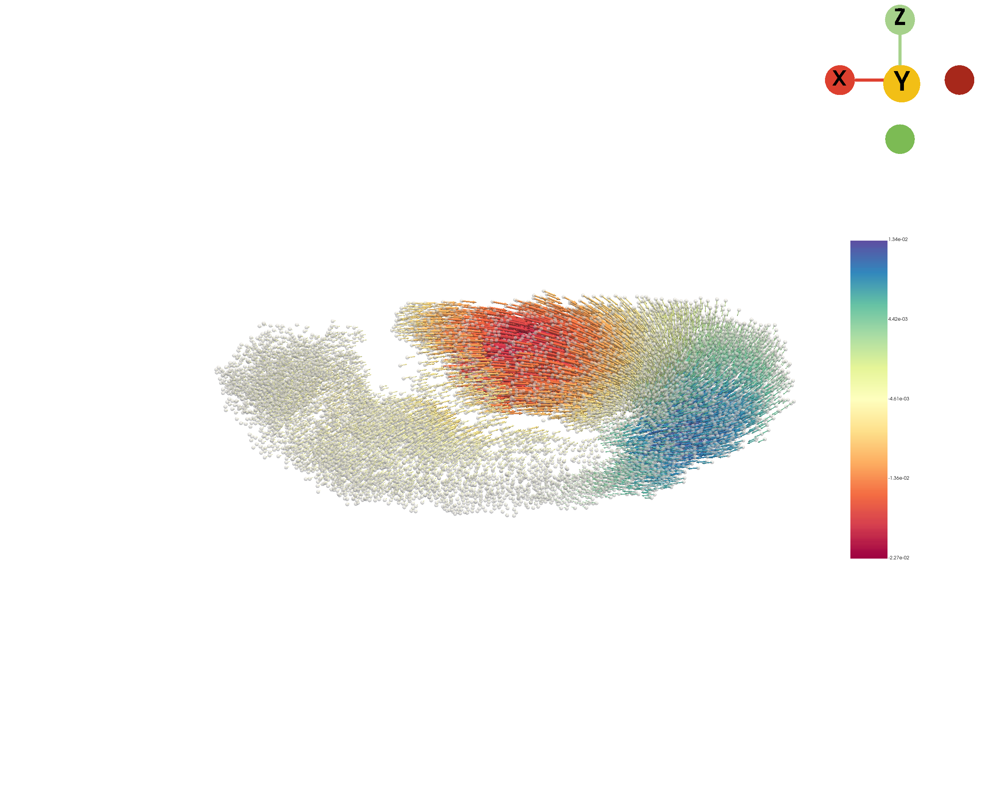

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


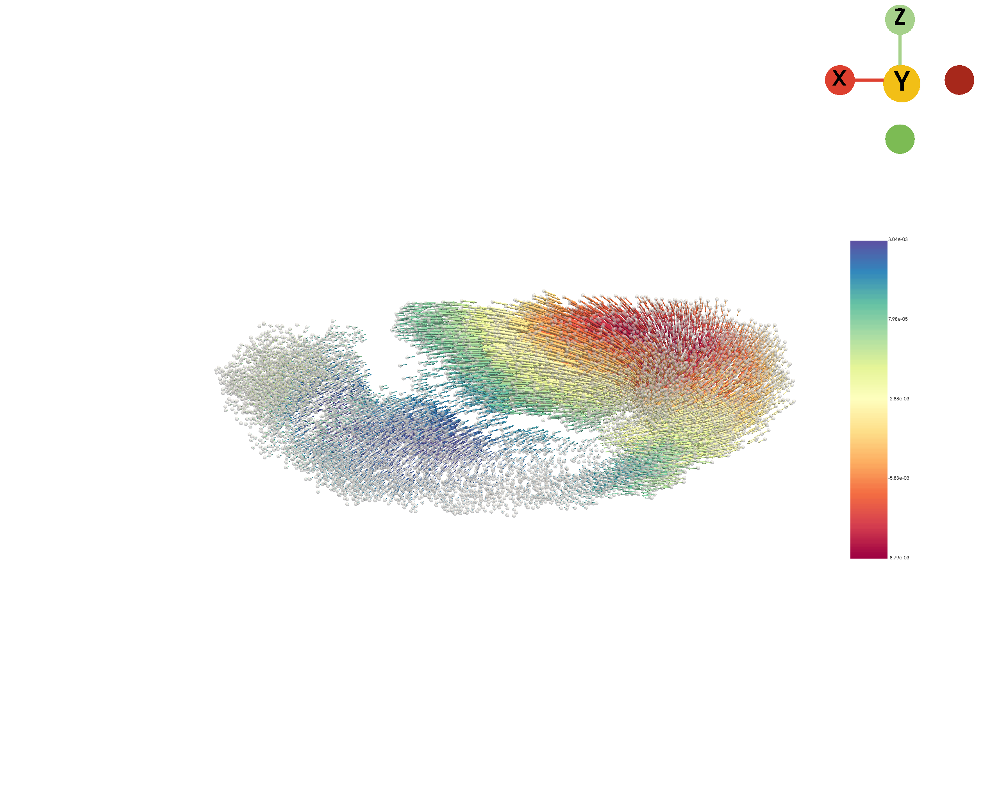

In [8]:
for i, k in zip([0, 2], ["V_x", "V_z"]):
    vector_arrows1,_ = st.tdr.construct_field(
        model=germ_pc,
        vf_key="vectors",
        arrows_scale_key="vectors",
        n_sampling=None,
        factor=1000,
        key_added=k,
        label=germ_pc.point_data["vectors"][:, i].flatten(),
        color= "rainbow",
    )
    st.pl.three_d_plot(
        model=st.tdr.collect_models([germ_pc, vector_arrows1]),
        key=["tissue", k],
        colormap=["gainsboro", "Spectral"],
        opacity=[0.5, 1],
        model_style=["points", "surface"],
        model_size=[10, 5],
        jupyter="static",
        background="white",
        window_size=(2560, 2048),
        cpo=cpo,
        filename=os.path.join(out_image_path, f"germband_morphofield_vector_arrows_pc_model_{k}.pdf")
    )

## Predict the cell developmentalal trajectory

In [ ]:
st.tdr.morphopath(
    adata=germ_adata,
    # layer="log1p_X",
    vf_key="VecFld_morpho",
    key_added="fate_morpho",
    t_end=2000,
    interpolation_num=50,
    cores=20
)

In [ ]:
trajectory_model, _ = st.tdr.construct_trajectory(
    adata=germ_adata,
    fate_key="fate_morpho",
    n_sampling=1500,
    sampling_method="trn",
    key_added="obs_index",
    label=np.asarray(germ_adata.obs.index), # stage1_tissue_adata.uns["VecFld_morpho"]["V"][:, 2].flatten(),
)
for i, k in zip([0, 2], ["V_x", "V_z"]):
    germ_adata.obs[k] = germ_adata.uns["VecFld_morpho"]["V"][:, i].flatten()
    st.tdr.add_model_labels(
        model=trajectory_model,
        key_added=k,
        labels=np.asarray(germ_adata[np.asarray(trajectory_model.point_data["obs_index"])].obs[k]),
        colormap="Spectral",
        where="point_data",
        inplace=True,
    )
    st.pl.three_d_plot(
        model=st.tdr.collect_models([germ_pc, trajectory_model]),
        key=["tissue", k],
        opacity=[0.5, .5],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        colormap=["gainsboro", "Spectral"],
        jupyter="static",
        background="white",
        window_size=(2560, 2048),
        cpo=cpo,
        filename=os.path.join(out_image_path, f"germband_morphofield_trajectory_pc_model_{k}.pdf")
    )

## Animating cell fate prediction

In [9]:
cells_models, _ = st.tdr.construct_genesis(
    adata=germ_adata,
    fate_key="fate_morpho",
    n_steps = 100,
    logspace=True,
    t_end=1000,
    label=[germ_adata.uns["VecFld_morpho"]["V"][:, 0]] * 100,
    color="Spectral"
)
st.pl.three_d_animate(
    models=cells_models,
    stable_model=trajectory_model,
    key="genesis",
    stable_kwargs=dict(
        key="V_x",
        model_style="wireframe",
        model_size=5,
        opacity=0.5,
        colormap="Spectral",
        show_legend=False,
    ),
    filename=os.path.join(out_image_path, f"germband_morphofield_trajectory_model.mp4"),
    colormap="Spectral",
    model_style="points",
    model_size=10,
    jupyter="static",
    background="white",
    window_size=(2560, 2048),
    cpo=cpo,
    framerate=10)

In [10]:
cells_linear_models, _ = st.tdr.construct_genesis_X(
    stages_X=[germ_adata.obsm["3d_align_spatial"], germ_adata.obsm["X_cells_mapping"]],
    n_spacing=100,
    key_added="genesis",
    color="Spectral", 
    label=[germ_adata.uns["VecFld_morpho"]["V"][:, 0]] * (100 + 1),
)
st.pl.three_d_animate(
    models=cells_linear_models,
    stable_model=trajectory_model,
    key="genesis",
    stable_kwargs=dict(
        key="V_x",
        model_style="wireframe",
        model_size=5,
        opacity=0.5,
        colormap="Spectral",
        show_legend=False,
    ),
    filename=os.path.join(out_image_path, f"germband_morphofield_trajectory_model_linear.mp4"),
    model_style="points",
    model_size=10,
    colormap="Spectral",
    jupyter="static",
    background="white",
    window_size=(2560, 2048),
    cpo=cpo,
    framerate=10)

## Morphometrics feature

In [14]:
germ_adata.X = germ_adata.layers["X_counts"].copy()

In [15]:
st.tdr.morphofield_velocity(adata=germ_adata, vf_key="VecFld_morpho", key_added="morpho_velocity",)
st.tdr.morphofield_acceleration(adata=germ_adata, vf_key="VecFld_morpho", key_added="morpho_acceleration",)
st.tdr.morphofield_curvature(adata=germ_adata, vf_key="VecFld_morpho", key_added="morpho_curvature")
st.tdr.morphofield_curl(adata=germ_adata, vf_key="VecFld_morpho", key_added="morpho_curl",)
st.tdr.morphofield_torsion(adata=germ_adata, vf_key="VecFld_morpho", key_added="morpho_torsion",)
germ_adata

|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0701s]
|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0550s]
|-----> [Calculating curvature] in progress: 100.0000%|-----> [Calculating curvature] completed [0.0967s]


Calculating 3-D curl: 100%|██████████| 12585/12585 [00:00<00:00, 80040.21it/s]


|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0546s]


Calculating torsion: 100%|██████████| 12585/12585 [00:00<00:00, 169775.20it/s]


AnnData object with n_obs × n_vars = 12585 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'glm_degs', 'log1p', 'pp', 'VecFld_morpho', 'fate_morpho', 'morpho_torsion'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial', 'morpho_velocity', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl'
    layers: 'X_counts', 'spliced', 'unspliced'

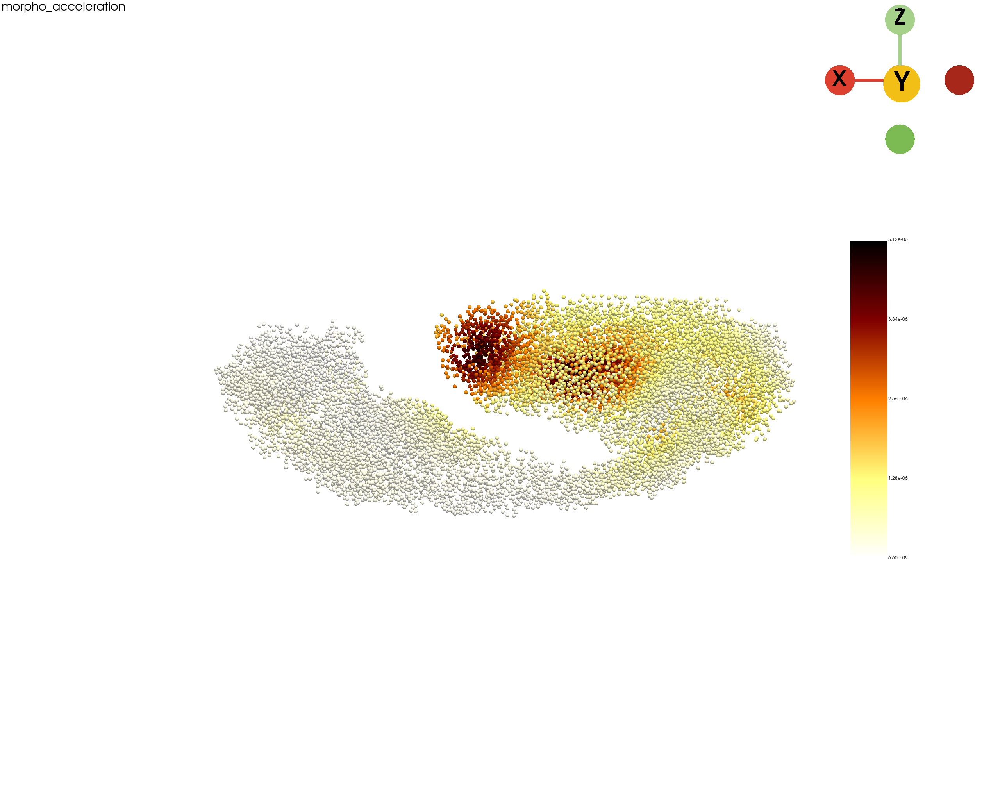

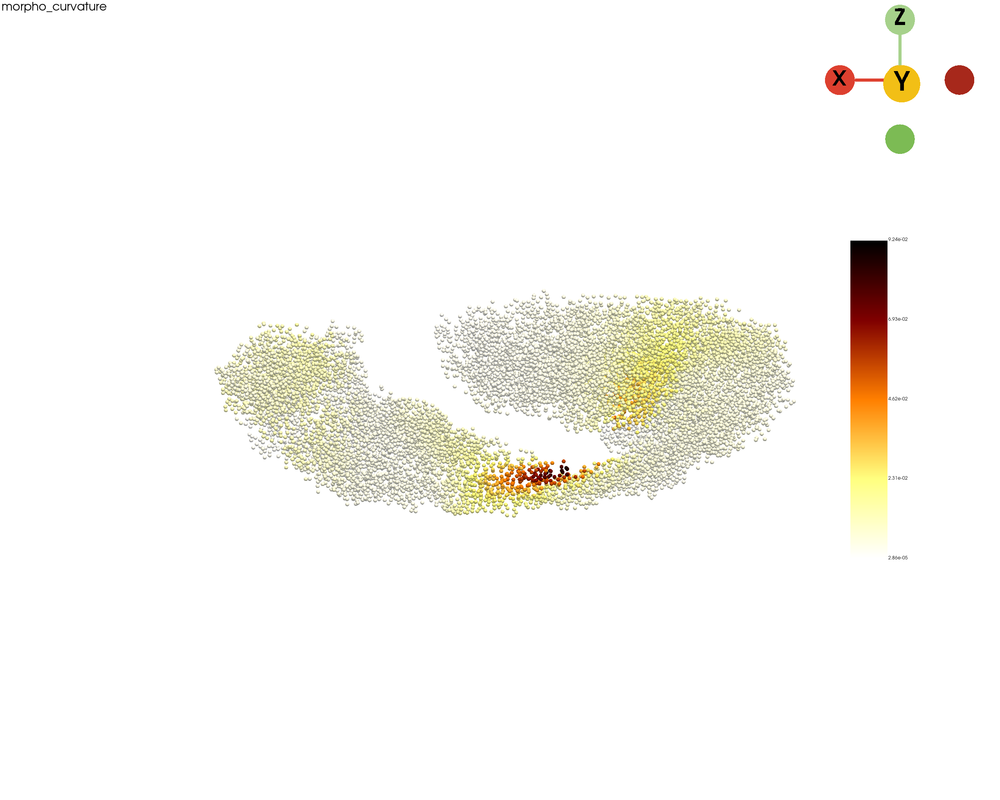

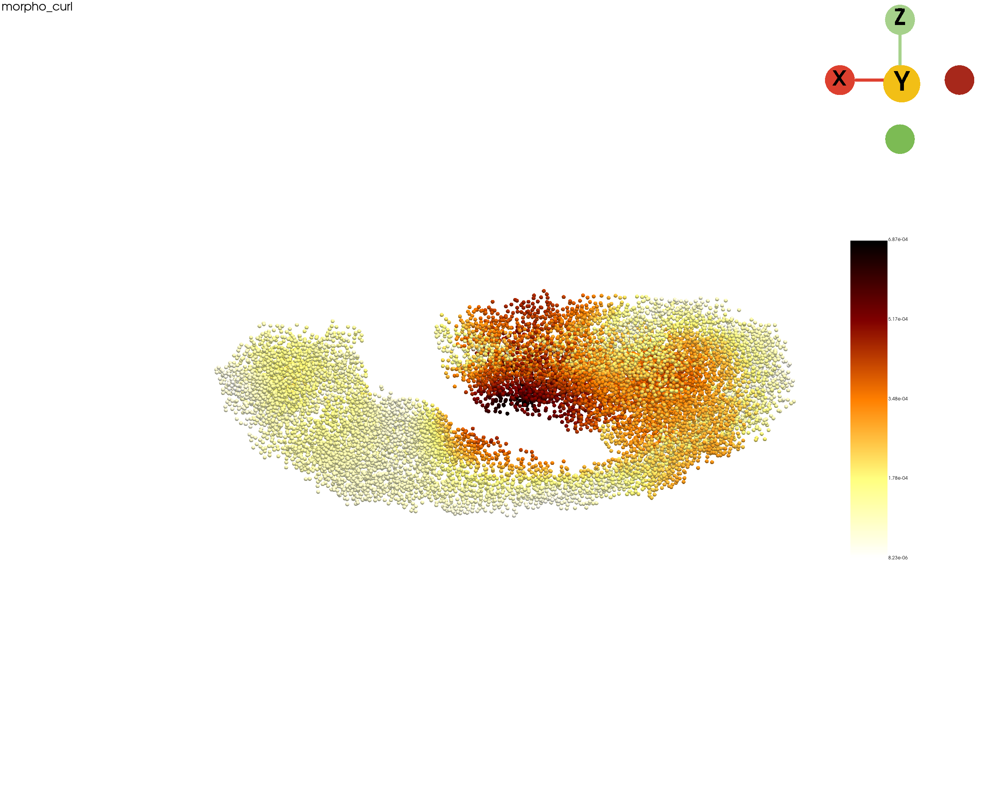

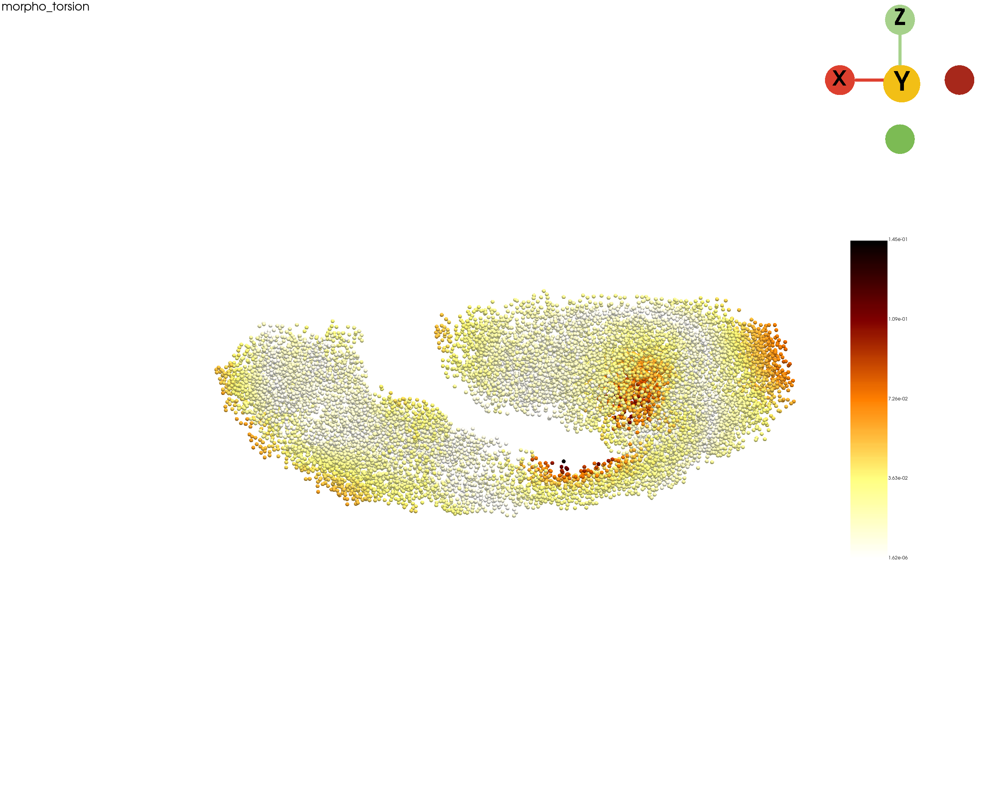

In [16]:
morphometrics_keys = ["morpho_acceleration", "morpho_curvature", "morpho_curl", "morpho_torsion"]
for mk in morphometrics_keys:
    pc_index=germ_pc.point_data["obs_index"].tolist()
    mmvalue = germ_adata[pc_index, :].obs[mk].values
    st.tdr.add_model_labels(model=germ_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=germ_pc,
        key=mk,
        model_style="points",
        model_size=10,
        opacity=1,
        colormap="afmhot_r", # Spectral_r
        show_legend=True,
        jupyter="static",
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"germband_morphometrics_{mk}.pdf")
    )

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


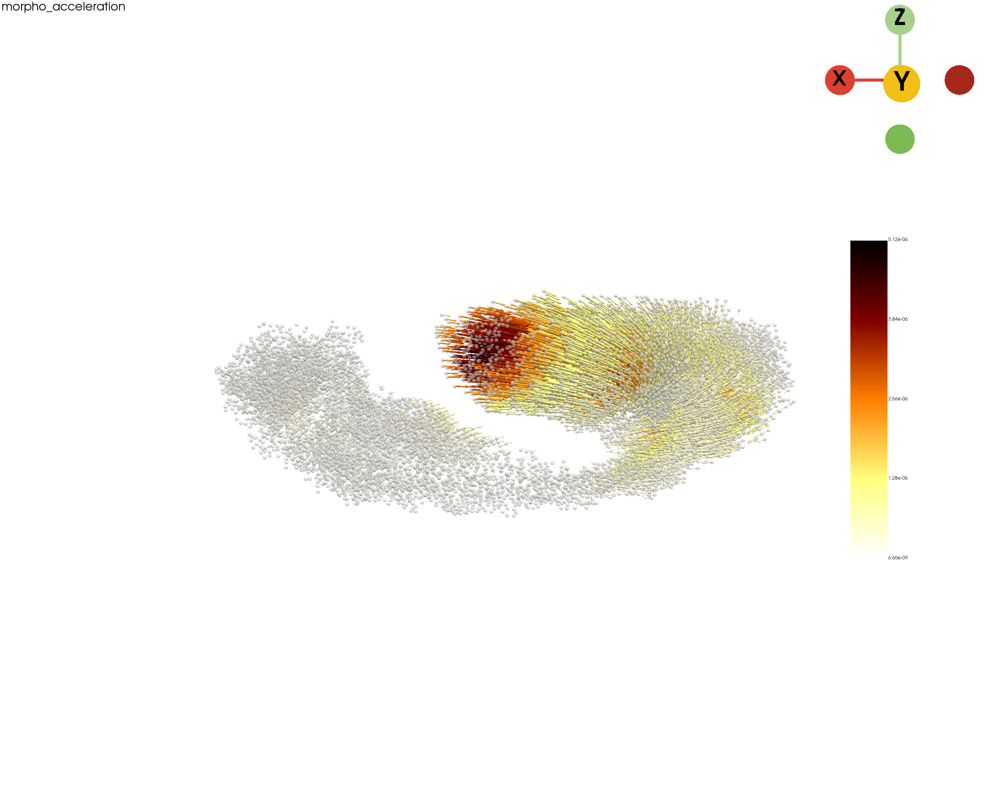

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


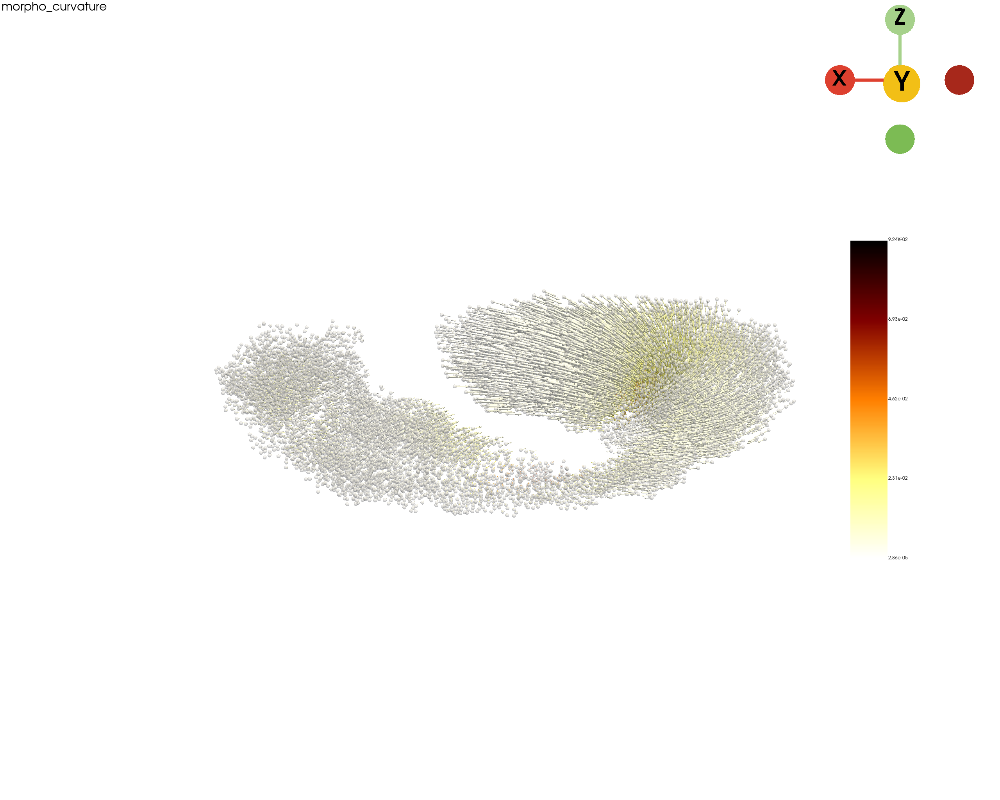

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


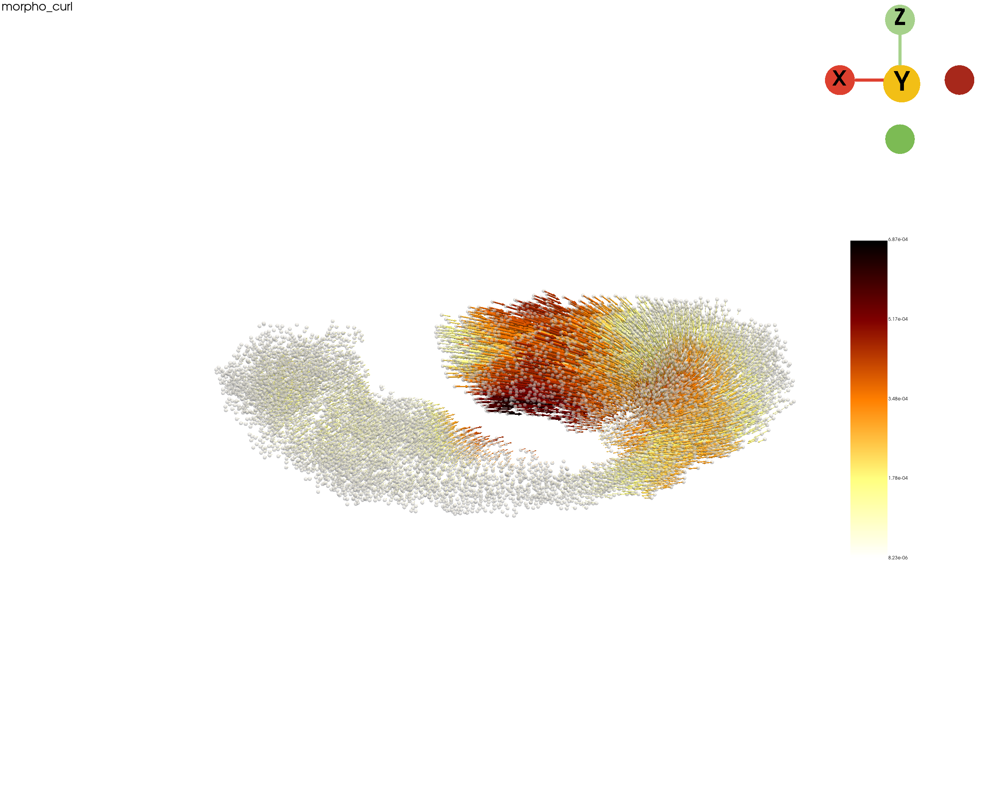

|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


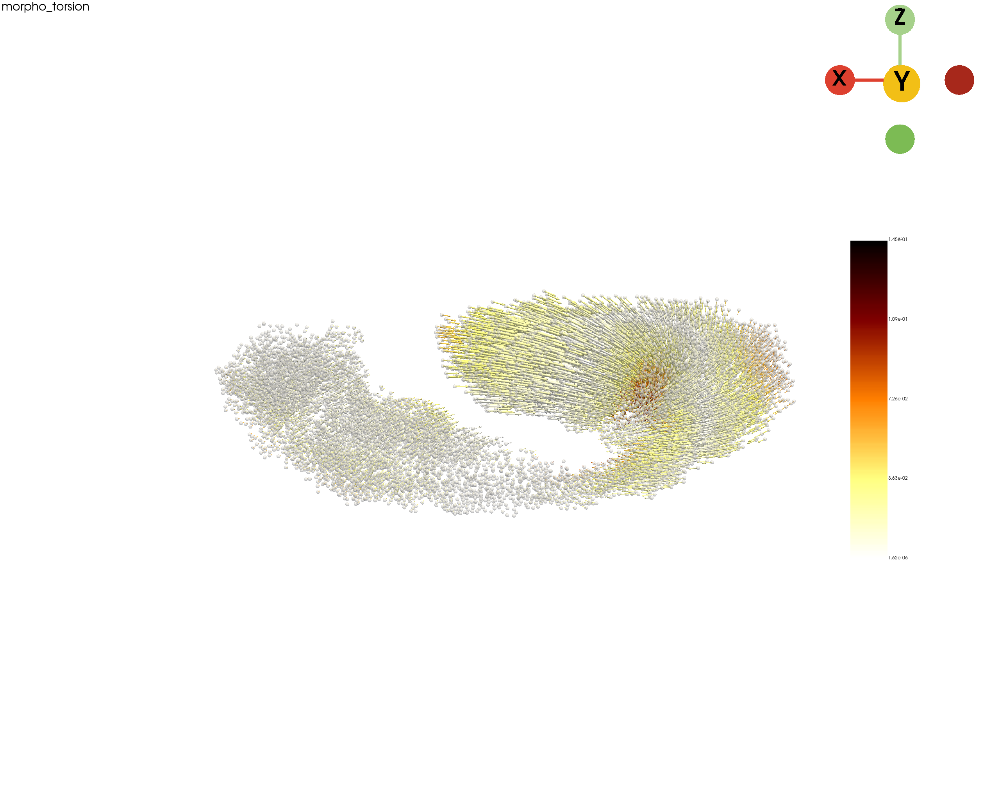

In [17]:
morphometrics_keys = ["morpho_acceleration", "morpho_curvature", "morpho_curl", "morpho_torsion"]
for mk in morphometrics_keys:
    vector_arrows,_ = st.tdr.construct_field(
        model=germ_pc,
        vf_key="vectors",
        arrows_scale_key="vectors",
        n_sampling=None,
        factor=1000,
        key_added=mk,
        label=np.asarray(germ_adata[np.asarray(germ_pc.point_data["obs_index"])].obs[mk]),
        color="afmhot_r",
    )
    st.pl.three_d_plot(
        model=st.tdr.collect_models([germ_pc, vector_arrows]),
        key=["tissue", mk],
        model_style=["points", "surface"],
        model_size=[10, 5],
        opacity=[0.5, 1],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"germband_morphometrics_{mk}_arrows.pdf")
    )

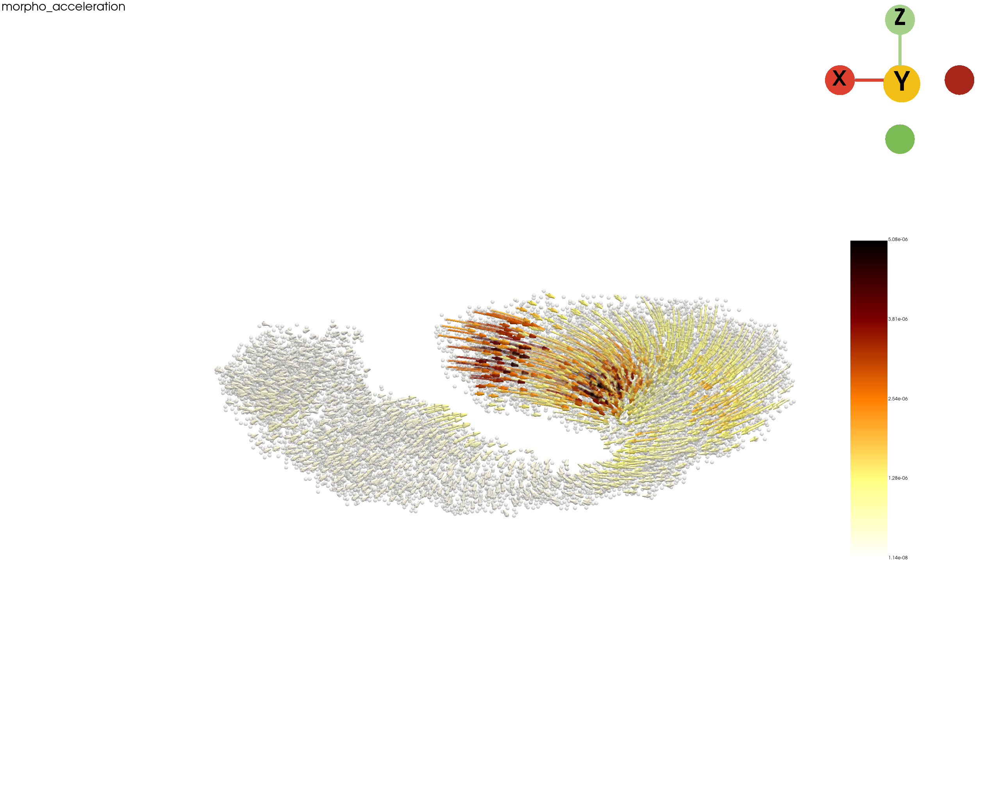

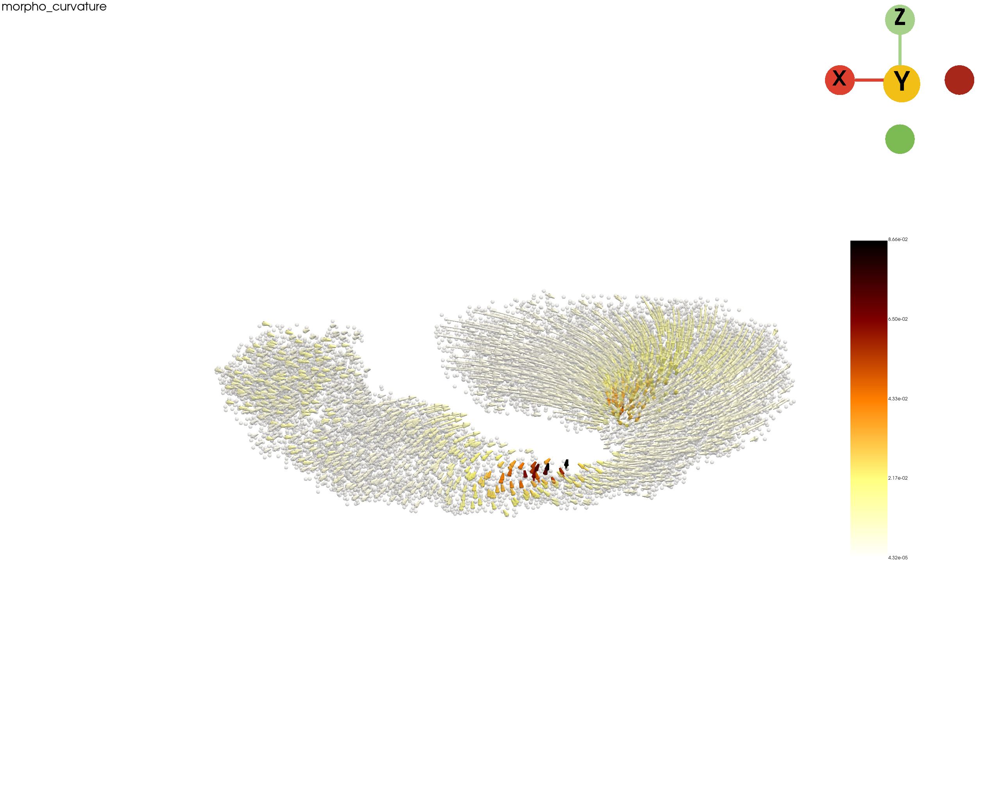

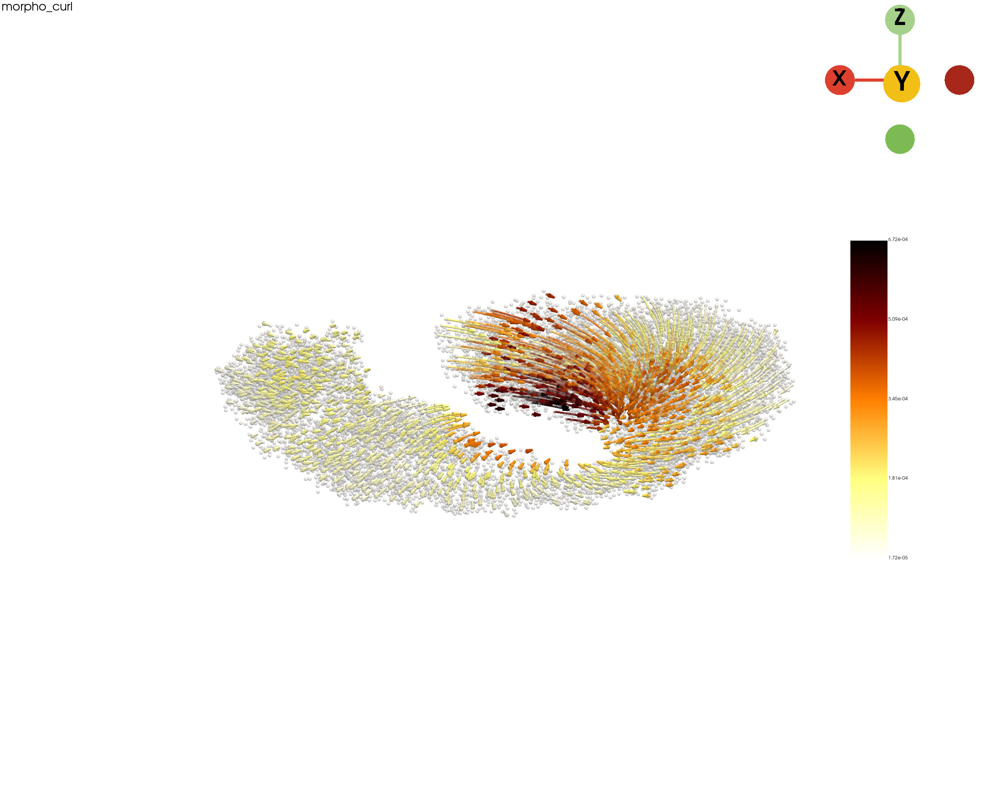

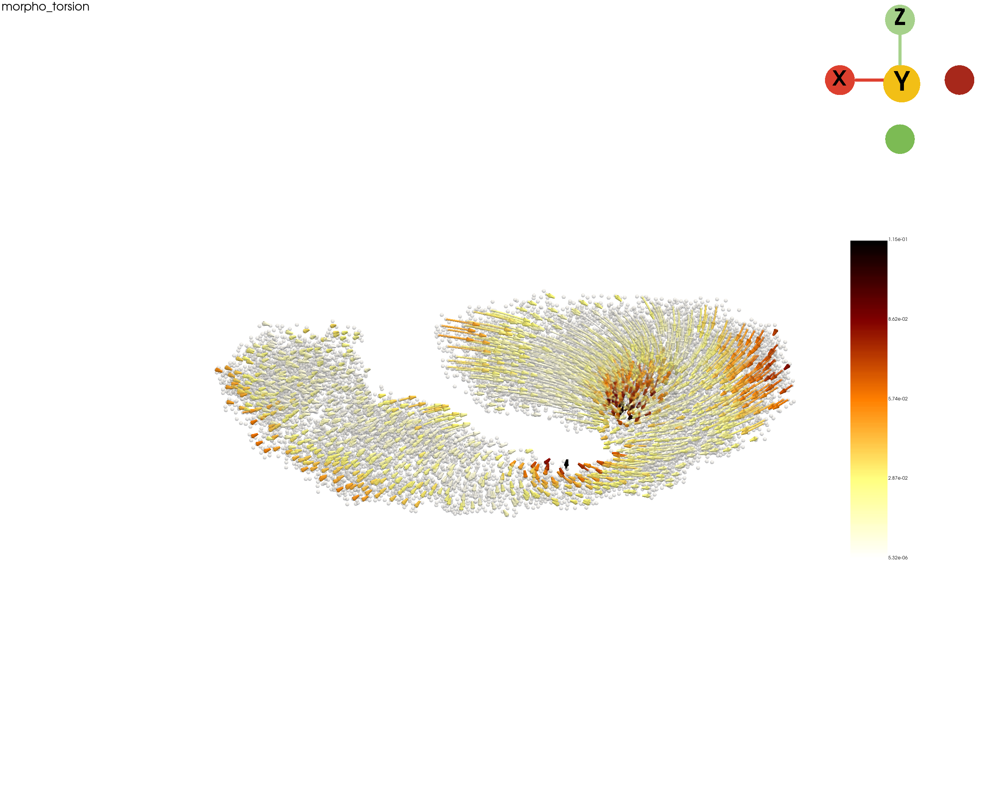

In [18]:
morphometrics_keys = ["morpho_acceleration", "morpho_curvature", "morpho_curl", "morpho_torsion"]
for mk in morphometrics_keys:
    st.tdr.add_model_labels(
        model=trajectory_model,
        key_added=mk,
        labels=np.asarray(germ_adata[np.asarray(trajectory_model.point_data["obs_index"])].obs[mk]),
        colormap="Spectral",
        where="point_data",
        inplace=True,
    )
    st.pl.three_d_plot(
        model=st.tdr.collect_models([germ_pc, trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"germband_morphometrics_{mk}_trajectory.pdf")
    )

## Acceleration with tissues

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


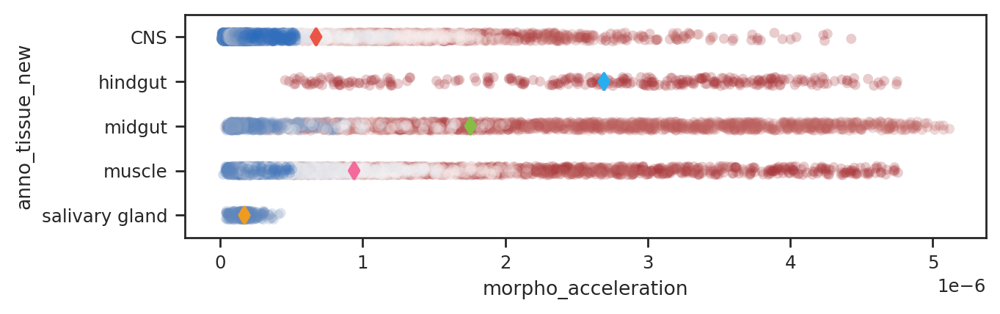

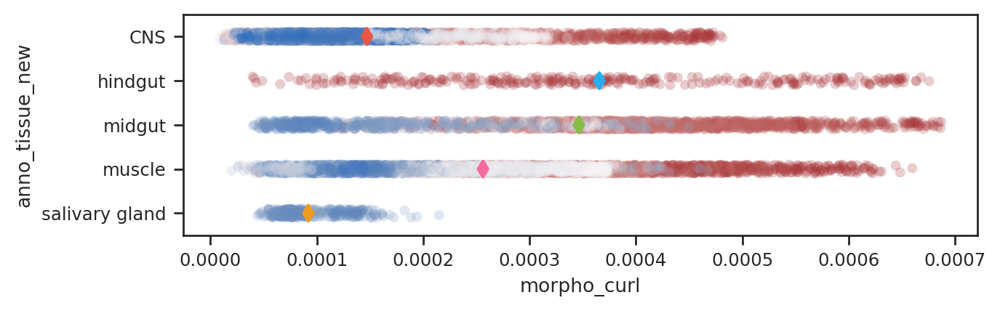

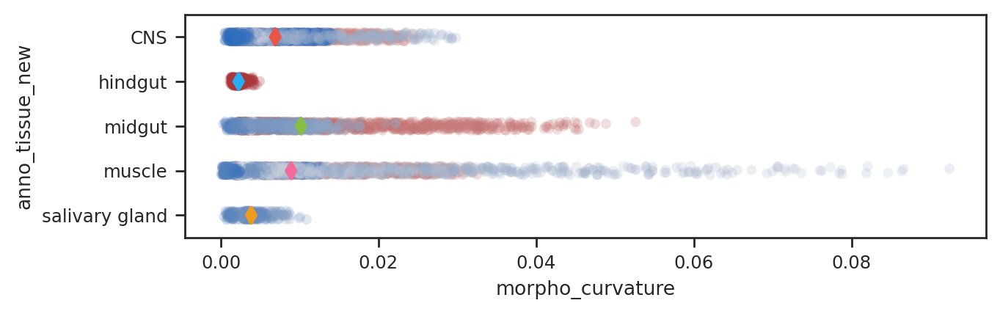

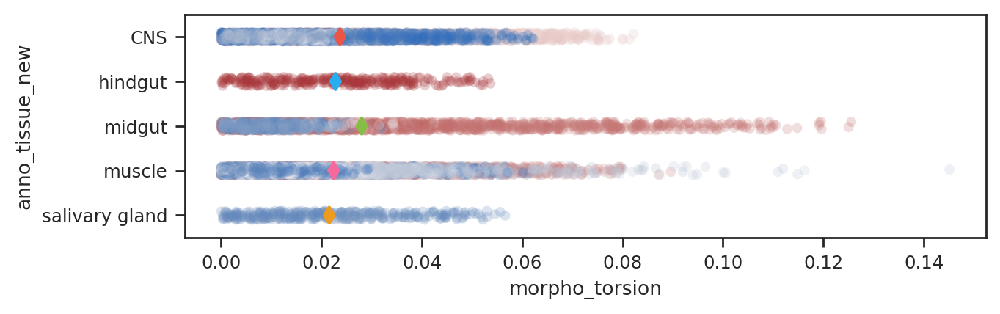

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt
germ_data = germ_adata.obs[["anno_tissue_new", "morpho_acceleration", "morpho_curl", "morpho_curvature", "morpho_torsion", "backbone_nodes"]]

sns.set_theme(context="paper", style="ticks", font="Arial")
for i in ["morpho_acceleration", "morpho_curl", "morpho_curvature", "morpho_torsion"]:
    f, ax = plt.subplots(figsize=(7, 2))
    # Show each observation with a scatterplot
    sns.stripplot(
        data=germ_data, x=i, y="anno_tissue_new", hue="backbone_nodes",
        alpha=.25, zorder=1, palette="vlag", legend=False,
    )
    
    sns.pointplot(
        data=germ_data, x=i, y="anno_tissue_new", 
        join=False, dodge=.8 - .8 / 3, palette={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",},
        markers="d", scale=1, errorbar=None,
    )
    plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_{i}_tissues_scatterplot.pdf"), dpi=300, format="pdf", bbox_inches="tight")
    plt.show()

## Save the anndata objects and models

In [20]:
del germ_adata.uns["fate_morpho"], germ_adata.uns["morpho_torsion"]
germ_adata.write_h5ad(f"h5ad/{sample_id}_germband_v4.h5ad", compression="gzip")
germ_adata

AnnData object with n_obs × n_vars = 12585 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'glm_degs', 'log1p', 'pp', 'VecFld_morpho'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial', 'morpho_velocity', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl'
    layers: 'X_counts', 'spliced', 'unspliced'

In [21]:
st.tdr.save_model(model=germ_pc, filename=f"morpho_models/germband_morphometrics_pc_model.vtk")
st.tdr.save_model(model=germ_mesh, filename=f"morpho_models/germband_morphometrics_mesh_model.vtk")
st.tdr.save_model(model=trajectory_model, filename=f"morpho_models/germband_morphofield_trajectory_model.vtk")